<a href="https://colab.research.google.com/github/itzaamer/Hindi-Character-recognition/blob/main/Hindi_character_modelling_%20Pretrained%20model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import tensorflow as tf
import os
import numpy as np
import matplotlib.pyplot as plt
import cv2 as cv
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Activation, Flatten, Conv2D, MaxPooling2D

Loading our X_train.y_train,x_test,y_test

In [3]:
# Loading the data
import pickle
def load_data():
    X_train = pickle.load(open("/content/drive/MyDrive/case study -2/X_train.pickle", "rb"))
    X_test = pickle.load(open("/content/drive/MyDrive/case study -2/X_test.pickle", "rb"))
    y_train = pickle.load(open("/content/drive/MyDrive/case study -2/y_train.pickle", "rb"))
    y_test = pickle.load(open("/content/drive/MyDrive/case study -2/y_test.pickle", "rb"))
    
    return X_train, X_test, y_train, y_test



X_train, X_test, y_train, y_test = load_data()

In [4]:
#let print the shape of the X_train, X_test, y_train, y_test
print("X_train shape",X_train.shape)
print("X_test shape",X_test.shape)
print("y_train shape",y_train.shape)
print("y_test shape",y_test.shape)

X_train shape (62560, 32, 32, 1)
X_test shape (15640, 32, 32, 1)
y_train shape (62560, 46)
y_test shape (15640, 46)


<h2>Model-1

In [10]:
import keras
from keras.layers import Concatenate
from tensorflow.keras.optimizers import Adam
from tensorflow.keras import models, layers
from tensorflow.keras.models import Sequential
from keras.layers.convolutional import Conv2D, MaxPooling2D
from keras.layers.core import Flatten, Dense

In [ ]:
import os
os.environ['PYTHONHASHSEED'] = '0'

##https://keras.io/getting-started/faq/#how-can-i-obtain-reproducible-results-using-keras-during-development
## Have to clear the session. If you are not clearing, Graph will create again and again and graph size will increses. 
## Varibles will also set to some value from before session
tf.keras.backend.clear_session()

In [ ]:
# defining the architecture of the model
model = Sequential()

# First convolutional layer with max pooling
model.add(Conv2D(64, (3, 3), padding="same", input_shape=(32,32,1), activation="relu"))
model.add(MaxPooling2D(pool_size=(2, 2)))

# Hidden layer with 500 nodes
model.add(Flatten())
model.add(Dense(100, activation="relu"))

# Output layer with 32 nodes (one for each possible letter/number we predict)
model.add(Dense(46, activation="softmax"))

# Ask Keras to build the TensorFlow model behind the scenes
model.compile(loss="categorical_crossentropy", optimizer="adam", metrics=["accuracy"])
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 32, 32, 64)        640       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 16, 16, 64)       0         
 )                                                               
                                                                 
 flatten (Flatten)           (None, 16384)             0         
                                                                 
 dense (Dense)               (None, 100)               1638500   
                                                                 
 dense_1 (Dense)             (None, 46)                4646      
                                                                 
Total params: 1,643,786
Trainable params: 1,643,786
Non-trainable params: 0
______________________________________________

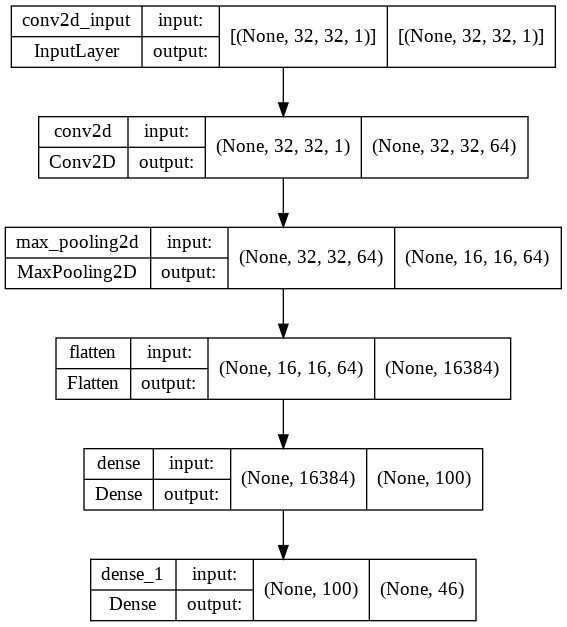

In [ ]:
from tensorflow.keras.utils import plot_model
plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

In [ ]:
from keras.callbacks import ModelCheckpoint
# checkpoint
filepath="/content/drive/MyDrive/case study -2/baseline_model/checkpoint-{epoch:02d}-{val_accuracy:.2f}.hdf5"
checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')

In [ ]:
earlystop = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=5)

In [ ]:
%reload_ext tensorboard

# Clear any logs from previous runs
!rm -rf ./logs/ 

import tensorflow as tf
import datetime

log_dir="logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir,histogram_freq=1)

In [ ]:
cp_callback = [earlystop,checkpoint,tensorboard_callback]

In [ ]:
# fitting the model
history1 = model.fit(X_train, y_train,
          validation_data=[X_test,y_test],
          batch_size=512, 
          epochs=10, 
          verbose=1,callbacks=[tensorboard_callback,earlystop,checkpoint])

Epoch 1/10
123/123 [==============================] - ETA: 0s - loss: 1.4541 - accuracy: 0.6246
Epoch 1: val_accuracy improved from -inf to 0.79086, saving model to /content/drive/MyDrive/case study -2/baseline_model/checkpoint-01-0.79.hdf5
123/123 [==============================] - 76s 607ms/step - loss: 1.4541 - accuracy: 0.6246 - val_loss: 0.7693 - val_accuracy: 0.7909
Epoch 2/10
123/123 [==============================] - ETA: 0s - loss: 0.5345 - accuracy: 0.8546
Epoch 2: val_accuracy improved from 0.79086 to 0.88063, saving model to /content/drive/MyDrive/case study -2/baseline_model/checkpoint-02-0.88.hdf5
123/123 [==============================] - 73s 592ms/step - loss: 0.5345 - accuracy: 0.8546 - val_loss: 0.4298 - val_accuracy: 0.8806
Epoch 3/10
123/123 [==============================] - ETA: 0s - loss: 0.3218 - accuracy: 0.9133
Epoch 3: val_accuracy improved from 0.88063 to 0.90697, saving model to /content/drive/MyDrive/case study -2/baseline_model/checkpoint-03-0.91.hdf5
123

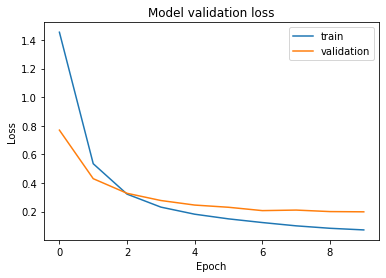

In [ ]:
plt.plot(history1.history['loss'])
plt.plot(history1.history['val_loss'])
plt.title('Model validation loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['train','validation'], loc='upper right')
plt.show()

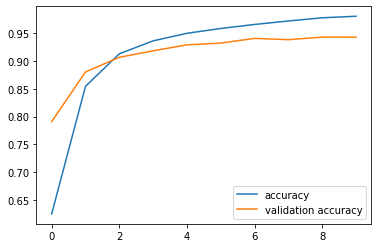

In [ ]:
plt.plot(history1.history['accuracy'],label='accuracy')
plt.plot(history1.history['val_accuracy'],label='validation accuracy')
plt.legend(loc='best')
plt.show()

In [ ]:
tensorboard --logdir logs/fit

<IPython.core.display.Javascript object>

In [ ]:
model.save('/content/drive/MyDrive/case study -2/baseline_model_save.h5')

In [ ]:
#from keras.models import load_model
#model1 = load_model('final_model.h5')

<h2>LENET MODEL

In [11]:
import tensorflow.keras
from tensorflow.keras import layers
from tensorflow.keras.layers import Conv2D,Flatten,MaxPooling2D
from tensorflow.keras.models import Model,Sequential
import matplotlib.pyplot as plt
import numpy as np
import math

In [ ]:
def LeNet( input_shape):
  inputs = tf.keras.Input(shape = input_shape)

  # Block 1 : CONV => POOL
  x = layers.Conv2D(6,kernel_size=5,activation='relu',
                   input_shape = input_shape, name = 'conv_layer1')(inputs)

  x = layers.MaxPooling2D(pool_size=(2,2),strides=2,
                             name = 'avg_pool1')(x)
  # Block 2  : CONV => POOL
  x = layers.Conv2D(16,kernel_size=5,activation='relu',
                   name = 'conv_layer2')(x)

  x = layers.MaxPooling2D(pool_size=(2,2),strides=2,
                             name = 'avg_pool2')(x)

  # Block 3  : CONV 
  x = layers.Conv2D(120,kernel_size=5,activation='relu',
                    name = 'conv_layer3')(x)

  x = layers.Flatten()(x)

  # Block 4  : FC1 => FC2 => SOFTMAX
  x = layers.Dense(120,activation='relu',name = 'fc1')(x)
  x = layers.Dense(84,activation='relu',name = 'fc2')(x)
  x = layers.Dense(46,activation='softmax',name = 'o/p')(x)

  # making model
  model = tf.keras.Model(inputs = inputs,outputs = x ,name="LeNet-5")
  model.summary()
  return model

In [ ]:
model_lenet = LeNet(input_shape=(32,32,1))

Model: "LeNet-5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 32, 32, 1)]       0         
                                                                 
 conv_layer1 (Conv2D)        (None, 28, 28, 6)         156       
                                                                 
 avg_pool1 (MaxPooling2D)    (None, 14, 14, 6)         0         
                                                                 
 conv_layer2 (Conv2D)        (None, 10, 10, 16)        2416      
                                                                 
 avg_pool2 (MaxPooling2D)    (None, 5, 5, 16)          0         
                                                                 
 conv_layer3 (Conv2D)        (None, 1, 1, 120)         48120     
                                                                 
 flatten (Flatten)           (None, 120)               0   

In [ ]:
model_lenet.compile(loss='categorical_crossentropy'
                    ,optimizer= 'rmsprop',metrics = ['accuracy'])

In [ ]:
hist1 = model_lenet.fit(X_train, y_train,
          validation_data=[X_test,y_test],
          batch_size=512, 
          epochs=10, 
          verbose=1)

Epoch 1/10
123/123 [==============================] - 12s 11ms/step - loss: 2.4059 - accuracy: 0.3593 - val_loss: 1.9663 - val_accuracy: 0.4402
Epoch 2/10
123/123 [==============================] - 1s 9ms/step - loss: 1.1771 - accuracy: 0.6629 - val_loss: 1.0141 - val_accuracy: 0.6927
Epoch 3/10
123/123 [==============================] - 1s 9ms/step - loss: 0.7538 - accuracy: 0.7753 - val_loss: 0.8783 - val_accuracy: 0.7333
Epoch 4/10
123/123 [==============================] - 1s 10ms/step - loss: 0.5347 - accuracy: 0.8388 - val_loss: 0.5146 - val_accuracy: 0.8394
Epoch 5/10
123/123 [==============================] - 1s 8ms/step - loss: 0.3953 - accuracy: 0.8793 - val_loss: 0.3988 - val_accuracy: 0.8748
Epoch 6/10
123/123 [==============================] - 1s 8ms/step - loss: 0.3165 - accuracy: 0.9018 - val_loss: 0.4231 - val_accuracy: 0.8699
Epoch 7/10
123/123 [==============================] - 1s 8ms/step - loss: 0.2556 - accuracy: 0.9208 - val_loss: 0.4414 - val_accuracy: 0.8648
Epo

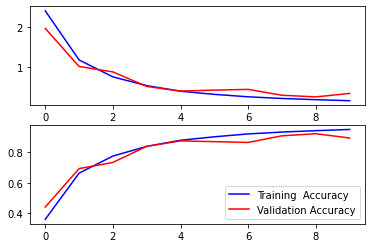

In [ ]:
import matplotlib.pyplot as plt
#Plotting the training and validation loss

f,ax=plt.subplots(2,1) #Creates 2 subplots under 1 column

#Assigning the first subplot to graph training loss and validation loss
ax[0].plot(model_lenet.history.history['loss'],color='b',label='Training Loss')
ax[0].plot(model_lenet.history.history['val_loss'],color='r',label='Validation Loss')

#Plotting the training accuracy and validation accuracy
ax[1].plot(model_lenet.history.history['accuracy'],color='b',label='Training  Accuracy')
ax[1].plot(model_lenet.history.history['val_accuracy'],color='r',label='Validation Accuracy')

plt.legend()

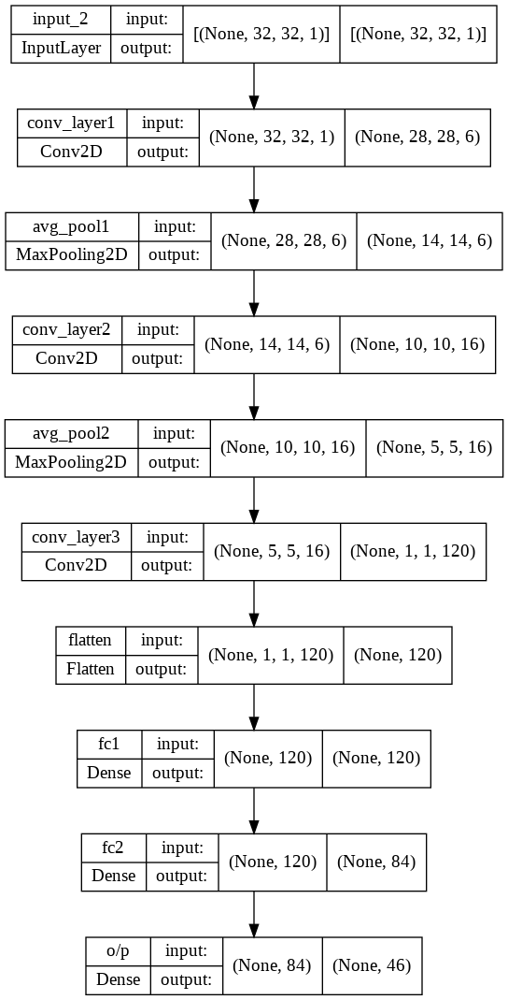

In [ ]:
from tensorflow.keras.utils import plot_model
plot_model(model_lenet, to_file='model_lenet.png', show_shapes=True, show_layer_names=True)

<h2> [VGG-16 with Modification]

<pre>
1. Use <a href='https://www.tensorflow.org/api_docs/python/tf/keras/applications/VGG16'>VGG-16</a> pretrained network without Fully Connected layers and initilize all the weights with Imagenet trained weights. 
2. After VGG-16 network without FC layers, add a new Conv block ( 1 Conv layer and 1 Maxpooling ), 2 FC layers and a output layer to classify 16 classes. You are free to choose any hyperparameters/parameters of conv block, FC layers, output layer. 
3. Final architecture will be <b>INPUT --> VGG-16 without Top layers(FC) --> Conv Layer --> Maxpool Layer --> 2 FC layers --> Output Layer</b>
4. Train only new Conv block, FC layers, output layer. Don't train the VGG-16 network. 

</pre>

In [ ]:
from keras.applications.vgg16 import VGG16
from keras.models import Model
from keras.layers import Dense
from keras.layers import Flatten
import os
os.environ['PYTHONHASHSEED'] = '0'

##https://keras.io/getting-started/faq/#how-can-i-obtain-reproducible-results-using-keras-during-development
## Have to clear the session. If you are not clearing, Graph will create again and again and graph size will increses. 
## Varibles will also set to some value from before session
tf.keras.backend.clear_session()

## Set the random seed values to regenerate the model.
np.random.seed(0)
rn.seed(0)

#Input layer
#input_layer = Input(shape=(156,256,3),name='Input_Layer')

## VGG16 Network
# load model without classifier layers
vgg_model_1 = VGG16(include_top=False, weights=None, input_shape=(32,32,1))
vgg_model_1.summary()

# Make vgg16 model layers as non trainable
for layer in vgg_model_1.layers:
    layer.trainable = False
vgg_model_1_Output = vgg_model_1.output

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 32, 32, 1)]       0         
                                                                 
 block1_conv1 (Conv2D)       (None, 32, 32, 64)        640       
                                                                 
 block1_conv2 (Conv2D)       (None, 32, 32, 64)        36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 16, 16, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 16, 16, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 16, 16, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 8, 8, 128)         0     

In [ ]:
#Flatten
flatten = Flatten(data_format='channels_last',name='Flatten')(vgg_model_1_Output)

#FC layer
FC1 = Dense(units=4096,activation='relu',kernel_initializer=tf.keras.initializers.glorot_normal(seed=32),name='FC1')(flatten)

#FC layer
FC2 = Dense(units=4096,activation='relu',kernel_initializer=tf.keras.initializers.glorot_normal(seed=33),name='FC2')(FC1)
# RELU activation for both the dense layer of 4096 units so that I stop forwarding negative values through the network.
#output layer
Out = Dense(units=46,activation='softmax',kernel_initializer=tf.keras.initializers.glorot_normal(seed=31),name='Output')(FC2)
#16 unit dense layer in the end with softmax activation as I have 16 classes
#define new model
model = Model(inputs=vgg_model_1.input,outputs=Out)
# summarize
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 32, 32, 1)]       0         
                                                                 
 block1_conv1 (Conv2D)       (None, 32, 32, 64)        640       
                                                                 
 block1_conv2 (Conv2D)       (None, 32, 32, 64)        36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 16, 16, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 16, 16, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 16, 16, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 8, 8, 128)         0     

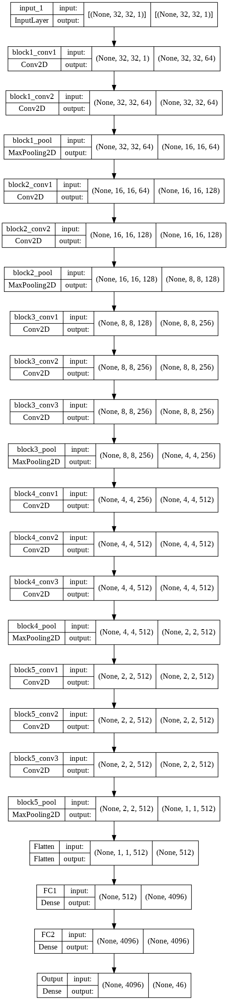

In [ ]:
from tensorflow.keras.utils import plot_model
plot_model(model, to_file='model.png', show_shapes=True, show_layer_names=True)

In [ ]:
from keras.callbacks import ModelCheckpoint
# checkpoint
filepath="/content/drive/MyDrive/case study -2/model/checkpoint-{epoch:02d}-{val_accuracy:.2f}.hdf5"
checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')

In [ ]:
earlystop = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=5)

In [ ]:
%reload_ext tensorboard

# Clear any logs from previous runs
!rm -rf ./logs/ 

import tensorflow as tf
import datetime

log_dir="logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir,histogram_freq=1)

In [ ]:
cp_callback = [earlystop,checkpoint,tensorboard_callback]

In [ ]:
# Ask Keras to build the TensorFlow model behind the scenes
model.compile(loss="categorical_crossentropy", optimizer="adam", metrics=["accuracy"])

In [ ]:
# fitting the model
history3 = model.fit(X_train, y_train,
          validation_data=[X_test,y_test],
          batch_size=512, 
          epochs=10, 
          verbose=1,callbacks=[tensorboard_callback,earlystop,checkpoint])

Epoch 1/10
123/123 [==============================] - ETA: 0s - loss: 3.8290 - accuracy: 0.0207
Epoch 1: val_accuracy improved from -inf to 0.02033, saving model to /content/drive/MyDrive/case study -2/model/checkpoint-01-0.02.hdf5
123/123 [==============================] - 49s 312ms/step - loss: 3.8290 - accuracy: 0.0207 - val_loss: 3.8289 - val_accuracy: 0.0203
Epoch 2/10
123/123 [==============================] - ETA: 0s - loss: 3.8288 - accuracy: 0.0209
Epoch 2: val_accuracy did not improve from 0.02033
123/123 [==============================] - 29s 236ms/step - loss: 3.8288 - accuracy: 0.0209 - val_loss: 3.8289 - val_accuracy: 0.0195
Epoch 3/10
123/123 [==============================] - ETA: 0s - loss: 3.8286 - accuracy: 0.0221
Epoch 3: val_accuracy improved from 0.02033 to 0.03708, saving model to /content/drive/MyDrive/case study -2/model/checkpoint-03-0.04.hdf5
123/123 [==============================] - 35s 289ms/step - loss: 3.8286 - accuracy: 0.0221 - val_loss: 3.8281 - val_a

In [ ]:
tensorboard --logdir logs/fit

<IPython.core.display.Javascript object>

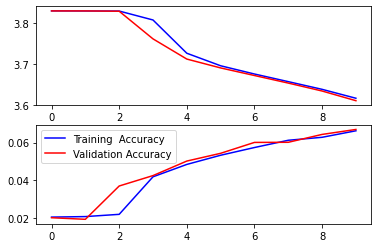

In [ ]:
import matplotlib.pyplot as plt
#Plotting the training and validation loss

f,ax=plt.subplots(2,1) #Creates 2 subplots under 1 column

#Assigning the first subplot to graph training loss and validation loss
ax[0].plot(model.history.history['loss'],color='b',label='Training Loss')
ax[0].plot(model.history.history['val_loss'],color='r',label='Validation Loss')

#Plotting the training accuracy and validation accuracy
ax[1].plot(model.history.history['accuracy'],color='b',label='Training  Accuracy')
ax[1].plot(model.history.history['val_accuracy'],color='r',label='Validation Accuracy')

plt.legend()

<h2> [VGG-16 with Modification]

<pre>
1. Use <a href='https://www.tensorflow.org/api_docs/python/tf/keras/applications/VGG16'>VGG-16</a> pretrained network without Fully Connected layers and initilize all the weights with Imagenet trained weights.
2. After VGG-16 network without FC layers, don't use FC layers, use conv layers only as Fully connected layer. any FC layer can be converted to a CONV layer. This conversion will reduce the No of Trainable parameters in FC layers. For example, an FC layer with K=4096 that is looking at some input volume of size 7×7×512 can be equivalently expressed as a CONV layer with F=7,P=0,S=1,K=4096. In other words, we are setting the filter size to be exactly the size of the input volume, and hence the output will simply be 1×1×4096 since only a single depth column “fits” across the input volume, giving identical result as the initial FC layer. You can refer <a href='http://cs231n.github.io/convolutional-networks/#convert'>this</a> link to better understanding of using Conv layer in place of fully connected layers.
3. Final architecture will be VGG-16 without FC layers(without top), 2 Conv layers identical to FC layers, 1 output layer for 16 class classification. <b>INPUT --> VGG-16 without Top layers(FC) --> 2 Conv Layers identical to FC --> Output Layer</b>
3. Train only last 2 Conv layers identical to FC layers, 1 output layer. Don't train the VGG-16 network. 
</pre>

In [ ]:
#importing tensorflow
from tensorflow.keras.layers import Dense,Input,Conv2D,MaxPool2D,Activation,Dropout,Flatten
from tensorflow.keras.models import Model
import random as rn


In [ ]:
import os
os.environ['PYTHONHASHSEED'] = '0'

##https://keras.io/getting-started/faq/#how-can-i-obtain-reproducible-results-using-keras-during-development
## Have to clear the session. If you are not clearing, Graph will create again and again and graph size will increses. 
## Varibles will also set to some value from before session
tf.keras.backend.clear_session()

## Set the random seed values to regenerate the model.
np.random.seed(0)
rn.seed(0)

## VGG16 Network

vgg_model_2 = VGG16(include_top=False, weights=None, input_shape=(32,32,1))
vgg_model_2.summary()

# Make vgg16 model layers as non trainable
for layer in vgg_model_2.layers:
    layer.trainable = False
vgg_model_2_Output = vgg_model_2.output



Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 32, 32, 1)]       0         
                                                                 
 block1_conv1 (Conv2D)       (None, 32, 32, 64)        640       
                                                                 
 block1_conv2 (Conv2D)       (None, 32, 32, 64)        36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 16, 16, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 16, 16, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 16, 16, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 8, 8, 128)         0     

In [ ]:
#Flatten
flatten = Flatten(data_format='channels_last',name='Flatten')(vgg_model_2_Output)
             
Out = Dense(units=46,activation='softmax',kernel_initializer=tf.keras.initializers.glorot_normal(seed=31),name='Output')(flatten)

#Creating a model
model_2 = Model(inputs=vgg_model_2.input,outputs=Out)
model_2.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 32, 32, 1)]       0         
                                                                 
 block1_conv1 (Conv2D)       (None, 32, 32, 64)        640       
                                                                 
 block1_conv2 (Conv2D)       (None, 32, 32, 64)        36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 16, 16, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 16, 16, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 16, 16, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 8, 8, 128)         0     

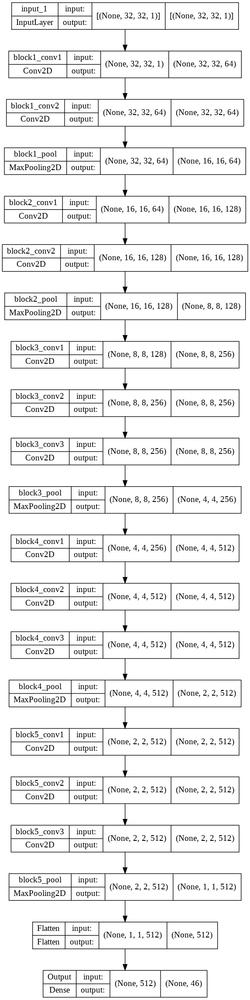

In [ ]:
from tensorflow.keras.utils import plot_model
plot_model(model_2, to_file='model_2.png', show_shapes=True, show_layer_names=True)

In [ ]:
from keras.callbacks import ModelCheckpoint
# checkpoint
filepath="/content/drive/MyDrive/case study -2/model_2/checkpoint-{epoch:02d}-{val_accuracy:.2f}.hdf5"
checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')

In [ ]:
earlystop = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=5)

In [ ]:
%reload_ext tensorboard

# Clear any logs from previous runs
!rm -rf ./logs/ 

import tensorflow as tf
import datetime

log_dir="logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir,histogram_freq=1)

In [ ]:
cp_callback = [earlystop,checkpoint,tensorboard_callback]

In [ ]:
# Ask Keras to build the TensorFlow model behind the scenes
model_2.compile(loss="categorical_crossentropy", optimizer="adam", metrics=["accuracy"])

In [ ]:
# fitting the model
history3 = model_2.fit(X_train, y_train,
          validation_data=[X_test,y_test],
          batch_size=512, 
          epochs=10, 
          verbose=1,callbacks=[tensorboard_callback,earlystop,checkpoint])

Epoch 1/10
122/123 [============================>.] - ETA: 0s - loss: 3.8286 - accuracy: 0.0218
Epoch 1: val_accuracy improved from -inf to 0.02020, saving model to /content/drive/MyDrive/case study -2/model_2/checkpoint-01-0.02.hdf5
123/123 [==============================] - 25s 192ms/step - loss: 3.8286 - accuracy: 0.0217 - val_loss: 3.8284 - val_accuracy: 0.0202
Epoch 2/10
122/123 [============================>.] - ETA: 0s - loss: 3.8281 - accuracy: 0.0230
Epoch 2: val_accuracy improved from 0.02020 to 0.02027, saving model to /content/drive/MyDrive/case study -2/model_2/checkpoint-02-0.02.hdf5
123/123 [==============================] - 21s 174ms/step - loss: 3.8281 - accuracy: 0.0230 - val_loss: 3.8281 - val_accuracy: 0.0203
Epoch 3/10
122/123 [============================>.] - ETA: 0s - loss: 3.8276 - accuracy: 0.0275
Epoch 3: val_accuracy did not improve from 0.02027
123/123 [==============================] - 21s 171ms/step - loss: 3.8276 - accuracy: 0.0275 - val_loss: 3.8277 - v

In [ ]:
tensorboard --logdir logs/fit

Reusing TensorBoard on port 6006 (pid 720), started 0:07:50 ago. (Use '!kill 720' to kill it.)

<IPython.core.display.Javascript object>

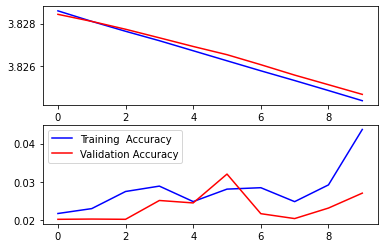

In [ ]:
import matplotlib.pyplot as plt
#Plotting the training and validation loss

f,ax=plt.subplots(2,1) #Creates 2 subplots under 1 column

#Assigning the first subplot to graph training loss and validation loss
ax[0].plot(model_2.history.history['loss'],color='b',label='Training Loss')
ax[0].plot(model_2.history.history['val_loss'],color='r',label='Validation Loss')

#Plotting the training accuracy and validation accuracy
ax[1].plot(model_2.history.history['accuracy'],color='b',label='Training  Accuracy')
ax[1].plot(model_2.history.history['val_accuracy'],color='r',label='Validation Accuracy')

plt.legend()

<h2>[VGG-16 with Modification]

<pre>
1. Use same network as Model-2 '<b>INPUT --> VGG-16 without Top layers(FC) --> 2 Conv Layers identical to FC --> Output Layer</b>' and train only Last 6 Layers of VGG-16 network, 2 Conv layers identical to FC layers, 1 output layer.
</pre>

In [ ]:
import os
os.environ['PYTHONHASHSEED'] = '0'

##https://keras.io/getting-started/faq/#how-can-i-obtain-reproducible-results-using-keras-during-development
## Have to clear the session. If you are not clearing, Graph will create again and again and graph size will increses. 
## Varibles will also set to some value from before session
tf.keras.backend.clear_session()

## Set the random seed values to regenerate the model.
np.random.seed(0)
rn.seed(0)

## VGG16 Network

vgg_model_3 = VGG16(include_top=False, weights=None, input_shape=(32,32,1))
vgg_model_3.summary()


Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 32, 32, 1)]       0         
                                                                 
 block1_conv1 (Conv2D)       (None, 32, 32, 64)        640       
                                                                 
 block1_conv2 (Conv2D)       (None, 32, 32, 64)        36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 16, 16, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 16, 16, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 16, 16, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 8, 8, 128)         0     

In [ ]:
#https://machinelearningmastery.com/how-to-use-transfer-learning-when-developing-convolutional-neural-network-models/
# mark loaded layers as not trainable
for layer in vgg_model_3.layers:
	layer.trainable = False
  #train only Last 6 Layers of VGG-16 network
for layer in vgg_model_3.layers[-6:]:#only for last 6
    layer.trainable = True
    print("Layer '%s' is trainable" % layer.name) 

model_vgg_3_Output = vgg_model_3.output

Layer 'block4_conv3' is trainable
Layer 'block4_pool' is trainable
Layer 'block5_conv1' is trainable
Layer 'block5_conv2' is trainable
Layer 'block5_conv3' is trainable
Layer 'block5_pool' is trainable


In [ ]:
#Flatten
flatten = Flatten(data_format='channels_last',name='Flatten')(model_vgg_3_Output)
             
Out = Dense(units=46,activation='softmax',kernel_initializer=tf.keras.initializers.glorot_normal(seed=31),name='Output')(flatten)

#Creating a model
model_3 = Model(inputs=vgg_model_3.input,outputs=Out)
model_3.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 32, 32, 1)]       0         
                                                                 
 block1_conv1 (Conv2D)       (None, 32, 32, 64)        640       
                                                                 
 block1_conv2 (Conv2D)       (None, 32, 32, 64)        36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 16, 16, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 16, 16, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 16, 16, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 8, 8, 128)         0   

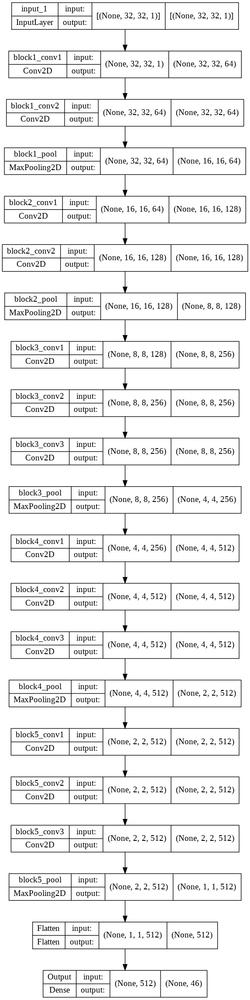

In [ ]:
from tensorflow.keras.utils import plot_model
plot_model(model_3, to_file='model_3.png', show_shapes=True, show_layer_names=True)

In [ ]:
from keras.callbacks import ModelCheckpoint
# checkpoint
filepath="/content/drive/MyDrive/case study -2/model_3/checkpoint-{epoch:02d}-{val_accuracy:.2f}.hdf5"
checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')

In [ ]:
earlystop = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=5)

In [ ]:
%reload_ext tensorboard

# Clear any logs from previous runs
!rm -rf ./logs/ 

import tensorflow as tf
import datetime

log_dir="logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir,histogram_freq=1)

In [ ]:
cp_callback = [earlystop,checkpoint,tensorboard_callback]

In [ ]:
# Ask Keras to build the TensorFlow model behind the scenes
model_3.compile(loss="categorical_crossentropy", optimizer="adam", metrics=["accuracy"])

In [ ]:
# fitting the model
history3 = model_3.fit(X_train, y_train,
          validation_data=[X_test,y_test],
          batch_size=512, 
          epochs=10, 
          verbose=1,callbacks=[tensorboard_callback,earlystop,checkpoint])

Epoch 1/10
123/123 [==============================] - ETA: 0s - loss: 3.3271 - accuracy: 0.1044
Epoch 1: val_accuracy improved from -inf to 0.26905, saving model to /content/drive/MyDrive/case study -2/model_3/checkpoint-01-0.27.hdf5
123/123 [==============================] - 35s 256ms/step - loss: 3.3271 - accuracy: 0.1044 - val_loss: 2.5320 - val_accuracy: 0.2691
Epoch 2/10
123/123 [==============================] - ETA: 0s - loss: 2.0697 - accuracy: 0.3766
Epoch 2: val_accuracy improved from 0.26905 to 0.44425, saving model to /content/drive/MyDrive/case study -2/model_3/checkpoint-02-0.44.hdf5
123/123 [==============================] - 32s 263ms/step - loss: 2.0697 - accuracy: 0.3766 - val_loss: 1.8155 - val_accuracy: 0.4442
Epoch 3/10
123/123 [==============================] - ETA: 0s - loss: 1.3740 - accuracy: 0.5685
Epoch 3: val_accuracy improved from 0.44425 to 0.64309, saving model to /content/drive/MyDrive/case study -2/model_3/checkpoint-03-0.64.hdf5
123/123 [===============

In [ ]:
tensorboard --logdir logs/fit

Reusing TensorBoard on port 6006 (pid 720), started 0:16:37 ago. (Use '!kill 720' to kill it.)

<IPython.core.display.Javascript object>

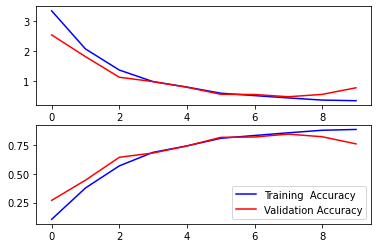

In [ ]:
import matplotlib.pyplot as plt
#Plotting the training and validation loss

f,ax=plt.subplots(2,1) #Creates 2 subplots under 1 column

#Assigning the first subplot to graph training loss and validation loss
ax[0].plot(model_3.history.history['loss'],color='b',label='Training Loss')
ax[0].plot(model_3.history.history['val_loss'],color='r',label='Validation Loss')

#Plotting the training accuracy and validation accuracy
ax[1].plot(model_3.history.history['accuracy'],color='b',label='Training  Accuracy')
ax[1].plot(model_3.history.history['val_accuracy'],color='r',label='Validation Accuracy')

plt.legend()

<h2>Resnet Model:

<pre>
1. Use <a href='https://www.tensorflow.org/api_docs/python/tf/keras/applications/resnet'>Resnet</a> pretrained network without Fully Connected layers and initilize all the weights with None trained weights. 
2. After Resnet network without FC layers, add a new Conv block ( 1 Conv layer and 1 Maxpooling ), 2 FC layers and a output layer to classify 46 classes. You are free to choose any hyperparameters/parameters of conv block, FC layers, output layer. 
3. Final architecture will be <b>INPUT --> Resnet without Top layers(FC) --> Conv Layer --> Maxpool Layer --> 2 FC layers --> Output Layer</b>
4. Train only new Conv block, FC layers, output layer. Don't train the Resnet network. 

</pre>

In [7]:
from tensorflow.keras.applications import ResNet50

base_model = ResNet50(input_shape=(32,32,1), include_top=False, weights=None)
base_model.summary()

Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 32, 32, 1)]  0           []                               
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 38, 38, 1)    0           ['input_2[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 16, 16, 64)   3200        ['conv1_pad[0][0]']              
                                                                                                  
 conv1_bn (BatchNormalization)  (None, 16, 16, 64)   256         ['conv1_conv[0][0]']             
                                                                                           

In [8]:
for layer in base_model.layers:
    layer.trainable = False
base_model_Output = base_model.output

In [12]:
#Flatten
flatten = Flatten(data_format='channels_last',name='Flatten')(base_model_Output)

#FC layer
FC1 = Dense(units=4096,activation='relu',kernel_initializer=tf.keras.initializers.glorot_normal(seed=32),name='FC1')(flatten)

#FC layer
FC2 = Dense(units=4096,activation='relu',kernel_initializer=tf.keras.initializers.glorot_normal(seed=33),name='FC2')(FC1)
# RELU activation for both the dense layer of 4096 units so that I stop forwarding negative values through the network.
#output layer
Out = Dense(units=46,activation='softmax',kernel_initializer=tf.keras.initializers.glorot_normal(seed=31),name='Output')(FC2)
#16 unit dense layer in the end with softmax activation as I have 16 classes
#define new model
model = Model(inputs=base_model.input,outputs=Out)
# summarize
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 32, 32, 1)]  0           []                               
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 38, 38, 1)    0           ['input_2[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 16, 16, 64)   3200        ['conv1_pad[0][0]']              
                                                                                                  
 conv1_bn (BatchNormalization)  (None, 16, 16, 64)   256         ['conv1_conv[0][0]']             
                                                                                              

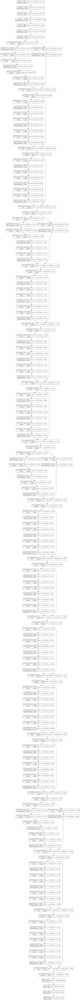

In [13]:
from tensorflow.keras.utils import plot_model
plot_model(model, to_file='model.png', show_shapes=True, show_layer_names=True)

In [14]:
earlystop = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=5)

In [15]:
%reload_ext tensorboard

# Clear any logs from previous runs
!rm -rf ./logs/ 

import tensorflow as tf
import datetime

log_dir="logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir,histogram_freq=1)

In [16]:
cp_callback = [earlystop,tensorboard_callback]

In [17]:
# Ask Keras to build the TensorFlow model behind the scenes
model.compile(loss="categorical_crossentropy", optimizer="adam", metrics=["accuracy"])

In [19]:
# fitting the model
history3 = model.fit(X_train, y_train,
          validation_data=[X_test,y_test],
          batch_size=512, 
          epochs=10, 
          verbose=1,callbacks=[tensorboard_callback,earlystop])

Epoch 1/10
123/123 [==============================] - 50s 297ms/step - loss: 3.0053 - accuracy: 0.1906 - val_loss: 2.3462 - val_accuracy: 0.3295
Epoch 2/10
123/123 [==============================] - 34s 279ms/step - loss: 2.0662 - accuracy: 0.4067 - val_loss: 1.8497 - val_accuracy: 0.4604
Epoch 3/10
123/123 [==============================] - 32s 263ms/step - loss: 1.6183 - accuracy: 0.5277 - val_loss: 1.4842 - val_accuracy: 0.5642
Epoch 4/10
123/123 [==============================] - 32s 263ms/step - loss: 1.3567 - accuracy: 0.5983 - val_loss: 1.2910 - val_accuracy: 0.6168
Epoch 5/10
123/123 [==============================] - 32s 260ms/step - loss: 1.2103 - accuracy: 0.6405 - val_loss: 1.3153 - val_accuracy: 0.6037
Epoch 6/10
123/123 [==============================] - 33s 272ms/step - loss: 1.1101 - accuracy: 0.6680 - val_loss: 1.1233 - val_accuracy: 0.6554
Epoch 7/10
123/123 [==============================] - 34s 273ms/step - loss: 1.0283 - accuracy: 0.6914 - val_loss: 1.0347 - val_ac

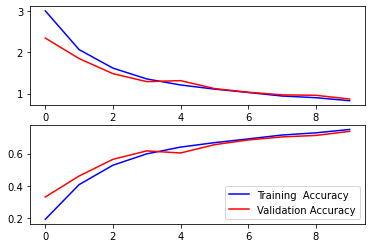

In [20]:
import matplotlib.pyplot as plt
#Plotting the training and validation loss

f,ax=plt.subplots(2,1) #Creates 2 subplots under 1 column

#Assigning the first subplot to graph training loss and validation loss
ax[0].plot(model.history.history['loss'],color='b',label='Training Loss')
ax[0].plot(model.history.history['val_loss'],color='r',label='Validation Loss')

#Plotting the training accuracy and validation accuracy
ax[1].plot(model.history.history['accuracy'],color='b',label='Training  Accuracy')
ax[1].plot(model.history.history['val_accuracy'],color='r',label='Validation Accuracy')

plt.legend()

<h2>Efficient Model:

<pre>
1. Use <a href='https://www.tensorflow.org/api_docs/python/tf/keras/applications/efficientnet'>efficientnet</a> pretrained network without Fully Connected layers and initilize all the weights with None trained weights. 
2. After efficientnet network without FC layers, add a new Conv block ( 1 Conv layer and 1 Maxpooling ), 2 FC layers and a output layer to classify 46 classes. You are free to choose any hyperparameters/parameters of conv block, FC layers, output layer. 
3. Final architecture will be <b>INPUT --> efficientnet without Top layers(FC) --> Conv Layer --> Maxpool Layer --> 2 FC layers --> Output Layer</b>
4. Train only new Conv block, FC layers, output layer. Don't train the efficientnet network. 

</pre>

In [21]:
!pip install -U efficientnet

     |████████████████████████████████| 50 kB 3.1 MB/s 


In [22]:
import efficientnet.keras as efn

In [25]:
base_model_1 = efn.EfficientNetB0(input_shape = (32,32,1), include_top = False, weights = None)
base_model_1.summary()

Model: "efficientnet-b0"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_5 (InputLayer)           [(None, 32, 32, 1)]  0           []                               
                                                                                                  
 stem_conv (Conv2D)             (None, 16, 16, 32)   288         ['input_5[0][0]']                
                                                                                                  
 stem_bn (BatchNormalization)   (None, 16, 16, 32)   128         ['stem_conv[0][0]']              
                                                                                                  
 stem_activation (Activation)   (None, 16, 16, 32)   0           ['stem_bn[0][0]']                
                                                                                    

In [26]:
for layer in base_model_1.layers:
    layer.trainable = False
base_model_1_Output = base_model_1.output

In [27]:
#Flatten
flatten = Flatten(data_format='channels_last',name='Flatten')(base_model_1_Output)

#FC layer
FC1 = Dense(units=4096,activation='relu',kernel_initializer=tf.keras.initializers.glorot_normal(seed=32),name='FC1')(flatten)

#FC layer
FC2 = Dense(units=4096,activation='relu',kernel_initializer=tf.keras.initializers.glorot_normal(seed=33),name='FC2')(FC1)
# RELU activation for both the dense layer of 4096 units so that I stop forwarding negative values through the network.
#output layer
Out = Dense(units=46,activation='softmax',kernel_initializer=tf.keras.initializers.glorot_normal(seed=31),name='Output')(FC2)
#16 unit dense layer in the end with softmax activation as I have 16 classes
#define new model
efficientnet_model = Model(inputs=base_model_1.input,outputs=Out)
# summarize
efficientnet_model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_5 (InputLayer)           [(None, 32, 32, 1)]  0           []                               
                                                                                                  
 stem_conv (Conv2D)             (None, 16, 16, 32)   288         ['input_5[0][0]']                
                                                                                                  
 stem_bn (BatchNormalization)   (None, 16, 16, 32)   128         ['stem_conv[0][0]']              
                                                                                                  
 stem_activation (Activation)   (None, 16, 16, 32)   0           ['stem_bn[0][0]']                
                                                                                            

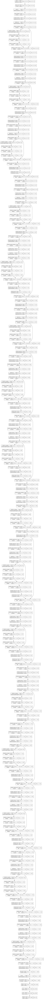

In [28]:
from tensorflow.keras.utils import plot_model
plot_model(efficientnet_model, to_file='efficientnet_model.png', show_shapes=True, show_layer_names=True)

In [29]:
earlystop = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=5)

In [30]:
%reload_ext tensorboard

# Clear any logs from previous runs
!rm -rf ./logs/ 

import tensorflow as tf
import datetime

log_dir="logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir,histogram_freq=1)

In [32]:
# Ask Keras to build the TensorFlow model behind the scenes
efficientnet_model.compile(loss="categorical_crossentropy", optimizer="adam", metrics=["accuracy"])

In [33]:
# fitting the model
history3 = efficientnet_model.fit(X_train, y_train,
          validation_data=[X_test,y_test],
          batch_size=512, 
          epochs=10, 
          verbose=1,callbacks=[tensorboard_callback,earlystop])

Epoch 1/10
123/123 [==============================] - 39s 248ms/step - loss: 3.8290 - accuracy: 0.0213 - val_loss: 3.8288 - val_accuracy: 0.0195
Epoch 2/10
123/123 [==============================] - 26s 213ms/step - loss: 3.8287 - accuracy: 0.0217 - val_loss: 3.8289 - val_accuracy: 0.0195
Epoch 3/10
123/123 [==============================] - 26s 212ms/step - loss: 3.8287 - accuracy: 0.0222 - val_loss: 3.8290 - val_accuracy: 0.0195
Epoch 4/10
123/123 [==============================] - 26s 212ms/step - loss: 3.8287 - accuracy: 0.0215 - val_loss: 3.8291 - val_accuracy: 0.0199
Epoch 5/10
123/123 [==============================] - 28s 226ms/step - loss: 3.8287 - accuracy: 0.0216 - val_loss: 3.8291 - val_accuracy: 0.0195
Epoch 6/10
123/123 [==============================] - 26s 212ms/step - loss: 3.8287 - accuracy: 0.0220 - val_loss: 3.8291 - val_accuracy: 0.0195
Epoch 7/10
123/123 [==============================] - 28s 225ms/step - loss: 3.8287 - accuracy: 0.0217 - val_loss: 3.8292 - val_ac

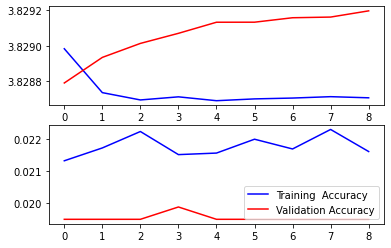

In [34]:
import matplotlib.pyplot as plt
#Plotting the training and validation loss

f,ax=plt.subplots(2,1) #Creates 2 subplots under 1 column

#Assigning the first subplot to graph training loss and validation loss
ax[0].plot(efficientnet_model.history.history['loss'],color='b',label='Training Loss')
ax[0].plot(efficientnet_model.history.history['val_loss'],color='r',label='Validation Loss')

#Plotting the training accuracy and validation accuracy
ax[1].plot(efficientnet_model.history.history['accuracy'],color='b',label='Training  Accuracy')
ax[1].plot(efficientnet_model.history.history['val_accuracy'],color='r',label='Validation Accuracy')

plt.legend()

<h2>Comparision:

In [1]:
from prettytable import PrettyTable    
x = PrettyTable()
x.field_names = ["Model","trainable layers","accuracy","Val_accuracy"]
x.add_row(['CNN-Model','Simple CNN Model','0.9810','0.9434'])
x.add_row(['Lenet-Model','Simple Model','0.9501','0.8939'])
x.add_row(['Vggmodel-1','without Top layers(FC)','0.0662','0.0669'])
x.add_row(['Vggmodel-2','without Top layers(FC)','0.0437','0.0270'])
x.add_row(['Vggmodel-3','Last 6 Layers of VGG-16 network','0.8848 ','0.7595'])
x.add_row(['Resnet Model','without Top layers(FC)','0.7504','0.7387'])
x.add_row(['efficientnet_model','without Top layers(FC)','0.0216','0.0195'])

print(x.get_string(title = "Model For classification"))

+--------------------------------------------------------------------------------+
|                            Model For classification                            |
+--------------------+---------------------------------+----------+--------------+
|       Model        |         trainable layers        | accuracy | Val_accuracy |
+--------------------+---------------------------------+----------+--------------+
|     CNN-Model      |         Simple CNN Model        |  0.9810  |    0.9434    |
|    Lenet-Model     |           Simple Model          |  0.9501  |    0.8939    |
|     Vggmodel-1     |      without Top layers(FC)     |  0.0662  |    0.0669    |
|     Vggmodel-2     |      without Top layers(FC)     |  0.0437  |    0.0270    |
|     Vggmodel-3     | Last 6 Layers of VGG-16 network | 0.8848   |    0.7595    |
|    Resnet Model    |      without Top layers(FC)     |  0.7504  |    0.7387    |
| efficientnet_model |      without Top layers(FC)     |  0.0216  |    0.0195    |
+---

- As we seen above Comparision table we seen that CNN - Model gives us Best Result. 
- We see that efficient model give us worst performance  